<a href="https://colab.research.google.com/github/GJ-007-sage/Astronomy/blob/main/2_body_simulation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation

In [ ]:
# Constants
gravitational_constant = 6.67430e-11  # m^3 kg^-1 s^-2

In [ ]:
# Define the two-body system
class TwoBodySystem:
    def __init__(self, m1, m2, r1, r2, v1, v2):
        self.m1 = m1  # Mass of body 1
        self.m2 = m2  # Mass of body 2
        self.r1 = np.array(r1, dtype=float)  # Position of body 1
        self.r2 = np.array(r2, dtype=float)  # Position of body 2
        self.v1 = np.array(v1, dtype=float)  # Velocity of body 1
        self.v2 = np.array(v2, dtype=float)  # Velocity of body 2

    def compute_accelerations(self):
        # Calculate the vector from body 1 to body 2
        r12 = self.r2 - self.r1
        distance = np.linalg.norm(r12)
        force_magnitude = gravitational_constant * self.m1 * self.m2 / distance**2
        force_direction = r12 / distance

        # Acceleration due to gravitational force
        a1 = force_magnitude / self.m1 * force_direction
        a2 = -force_magnitude / self.m2 * force_direction
        return a1, a2

    def update(self, dt):
        # Compute accelerations
        a1, a2 = self.compute_accelerations()

        # Update velocities
        self.v1 += a1 * dt
        self.v2 += a2 * dt

        # Update positions
        self.r1 += self.v1 * dt
        self.r2 += self.v2 * dt

In [ ]:
# Simulation parameters
m1, m2 = 5.972e24, 7.348e22  # Earth and Moon masses in kg
r1, r2 = [-1e7, 0], [1e7, 0]  # Initial positions in meters
v1, v2 = [0, -1e3], [0, 1e3]  # Initial velocities in m/s
dt = 60  # Time step in seconds
num_steps = 1000  # Number of steps

In [ ]:
# Initialize the system
system = TwoBodySystem(m1, m2, r1, r2, v1, v2)

In [ ]:
# Store trajectories
trajectory1 = []
trajectory2 = []

In [ ]:
# Run the simulation
for _ in range(num_steps):
    trajectory1.append(system.r1.copy())
    trajectory2.append(system.r2.copy())
    system.update(dt)

trajectory1 = np.array(trajectory1)
trajectory2 = np.array(trajectory2)

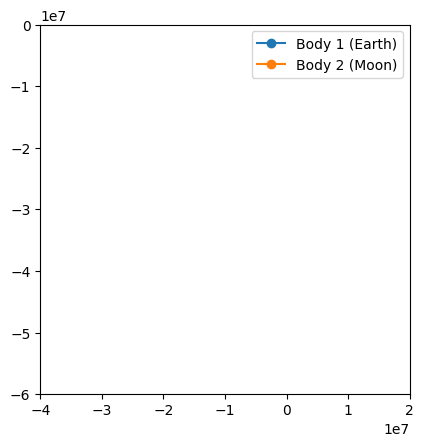

In [ ]:
# Animation setup
fig, ax = plt.subplots()
ax.set_xlim(-4e7, 2e7)
ax.set_ylim(-6e7, 0e7)
ax.set_aspect('equal', 'box')

line1, = ax.plot([], [], 'o-', label="Body 1 (Earth)")
line2, = ax.plot([], [], 'o-', label="Body 2 (Moon)")
trail1, = ax.plot([], [], '-', alpha=0.5)
trail2, = ax.plot([], [], '-', alpha=0.5)
ax.legend()

In [ ]:
!apt-get install -y ffmpeg


Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
ffmpeg is already the newest version (7:4.4.2-0ubuntu0.22.04.1).
0 upgraded, 0 newly installed, 0 to remove and 49 not upgraded.


In [ ]:
# Update function for animation


def update(frame):
    # Set the current position of the bodies
    line1.set_data([trajectory1[frame, 0]], [trajectory1[frame, 1]])
    line2.set_data([trajectory2[frame, 0]], [trajectory2[frame, 1]])

    # Set the trail of each body
    trail1.set_data(trajectory1[:frame+1, 0], trajectory1[:frame+1, 1])
    trail2.set_data(trajectory2[:frame+1, 0], trajectory2[:frame+1, 1])

    return line1, line2, trail1, trail2

from IPython.display import HTML

# Create the animation
ani = FuncAnimation(fig, update, frames=num_steps, interval=30, blit=True)

# Render the animation as HTML
HTML(ani.to_jshtml())



In [ ]:
# Increase embed limit
import matplotlib as mpl
mpl.rcParams['animation.embed_limit'] = 100  # 100 MB

# Save animation as a file
ani.save('two_body_simulation.mp4', writer='ffmpeg')

# Display as a video
from IPython.display import Video
Video('two_body_simulation.mp4', embed=True)


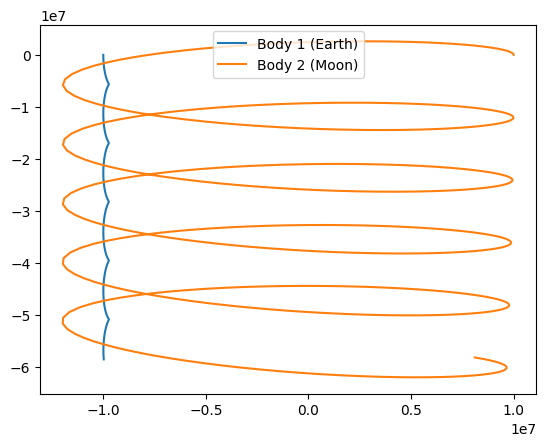

In [12]:
plt.plot(trajectory1[:, 0], trajectory1[:, 1], label="Body 1 (Earth)")
plt.plot(trajectory2[:, 0], trajectory2[:, 1], label="Body 2 (Moon)")
plt.legend()
plt.show()

In [13]:
print(trajectory1.shape)  # Should output: (1000, 2)
print(trajectory2.shape)  # Should output: (1000, 2)

(1000, 2)
(1000, 2)
